In [10]:
%matplotlib inline

import sys
import os
import numpy as np
import matplotlib.pyplot as plt
from osgeo import gdal
from skimage import exposure, img_as_float, morphology

In [2]:
# open geotiff
MS_filePath = "Image/PF/SPOT6_2015_HC_BRUT_NC_GEOSUD_MS_169/PROD_SPOT6_001/VOL_SPOT6_001_A/IMG_SPOT6_MS_001_A/"
MS_fileName = "IMG_SPOT6_MS_201510191942495_SEN_SPOT6_20160412_1415011xiteisuvwcqv_1_R1C1.TIF"
src_ds = gdal.Open( MS_filePath + MS_fileName )
# check validity
if src_ds is None:
    print('Unable to open .img file')
    sys.exit(1)

print('GeoTransform coefficient: ', str(src_ds.GetGeoTransform()))


GeoTransform coefficient:  (0.5, 1.0, 0.0, -0.5, 0.0, -1.0)


In [3]:
# check raster bands inventory
print("[ RASTER BAND COUNT ]: ", src_ds.RasterCount)
for band in range( src_ds.RasterCount ):
    band += 1
    print("[ GETTING BAND ]: ", band)
    srcband = src_ds.GetRasterBand(band)
    if srcband is None:
        continue

    stats = srcband.GetStatistics( True, True )
    if stats is None:
        continue

    print("[ STATS ] =  Minimum=%.3f, Maximum=%.3f, Mean=%.3f, StdDev=%.3f" % ( \
                stats[0], stats[1], stats[2], stats[3] ),'\n')

MData = src_ds.GetMetadata()    
print('Metadata: ',str(MData))

[ RASTER BAND COUNT ]:  4
[ GETTING BAND ]:  1
[ STATS ] =  Minimum=0.000, Maximum=3122.000, Mean=170.115, StdDev=144.703 

[ GETTING BAND ]:  2
[ STATS ] =  Minimum=0.000, Maximum=3604.000, Mean=305.662, StdDev=166.305 

[ GETTING BAND ]:  3
[ STATS ] =  Minimum=0.000, Maximum=3423.000, Mean=458.857, StdDev=123.056 

[ GETTING BAND ]:  4
[ STATS ] =  Minimum=0.000, Maximum=3198.000, Mean=255.085, StdDev=495.783 

Metadata:  {'TIFFTAG_DATETIME': '2016:04:12 16:04:48', 'TIFFTAG_IMAGEDESCRIPTION': 'B2, B1, B0, B3', 'TIFFTAG_XRESOLUTION': '1', 'TIFFTAG_YRESOLUTION': '1'}


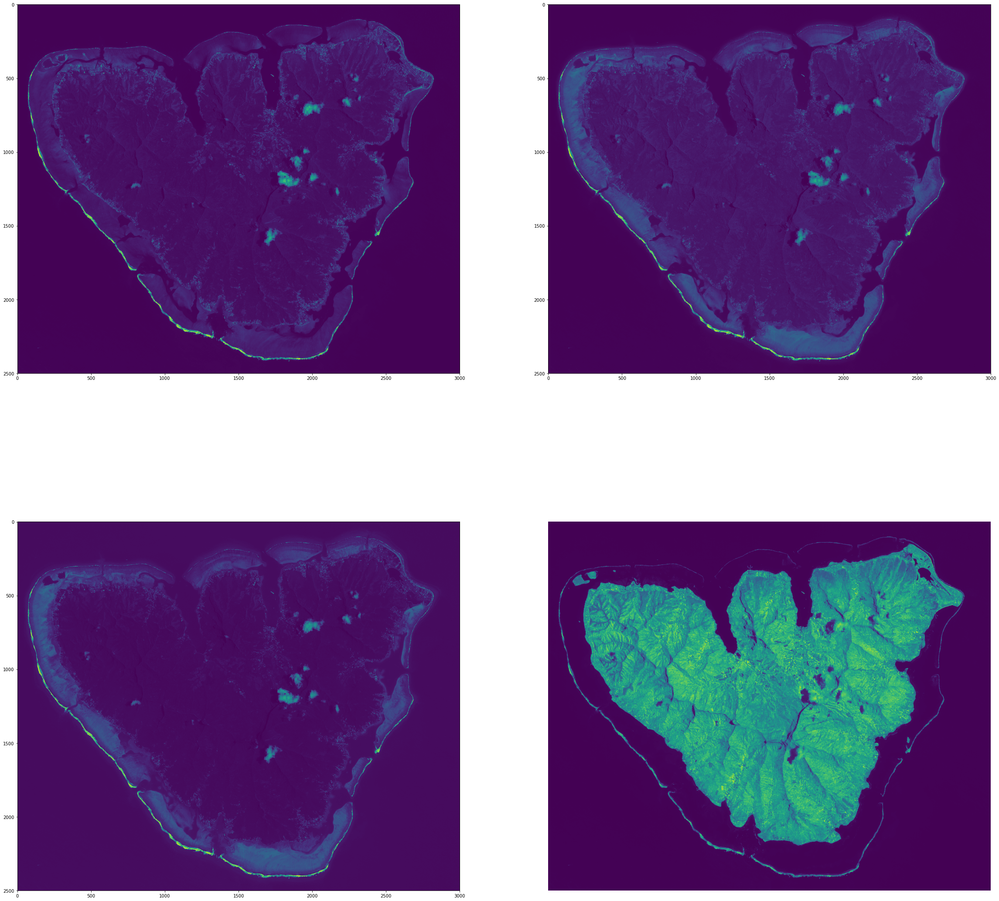

In [4]:
NIR = src_ds.GetRasterBand(4).ReadAsArray()
R = src_ds.GetRasterBand(1).ReadAsArray()
G = src_ds.GetRasterBand(2).ReadAsArray()
B = src_ds.GetRasterBand(3).ReadAsArray()
RGB_img = np.dstack((R[1000:3500,3400:6400],G[1000:3500,3400:6400],B[1000:3500,3400:6400]))
better_contrast = np.empty(RGB_img.shape, dtype= RGB_img.dtype)

plt.figure(figsize=(40, 40))
for i in range(1,4):
    plt.subplot(2, 2, i)
    plt.imshow(img_as_float(RGB_img[:,:,i-1]))
#    plt.axis('off')
#plt.subplot(1, 2, 2)
#plt.imshow(Random)

plt.subplot(2, 2, 4)
plt.imshow(img_as_float(NIR[1000:3500,3400:6400]))
plt.axis('off')
plt.show
plt.savefig("figures/ChannelTest.png", dpi='figure')


<function matplotlib.pyplot.show>

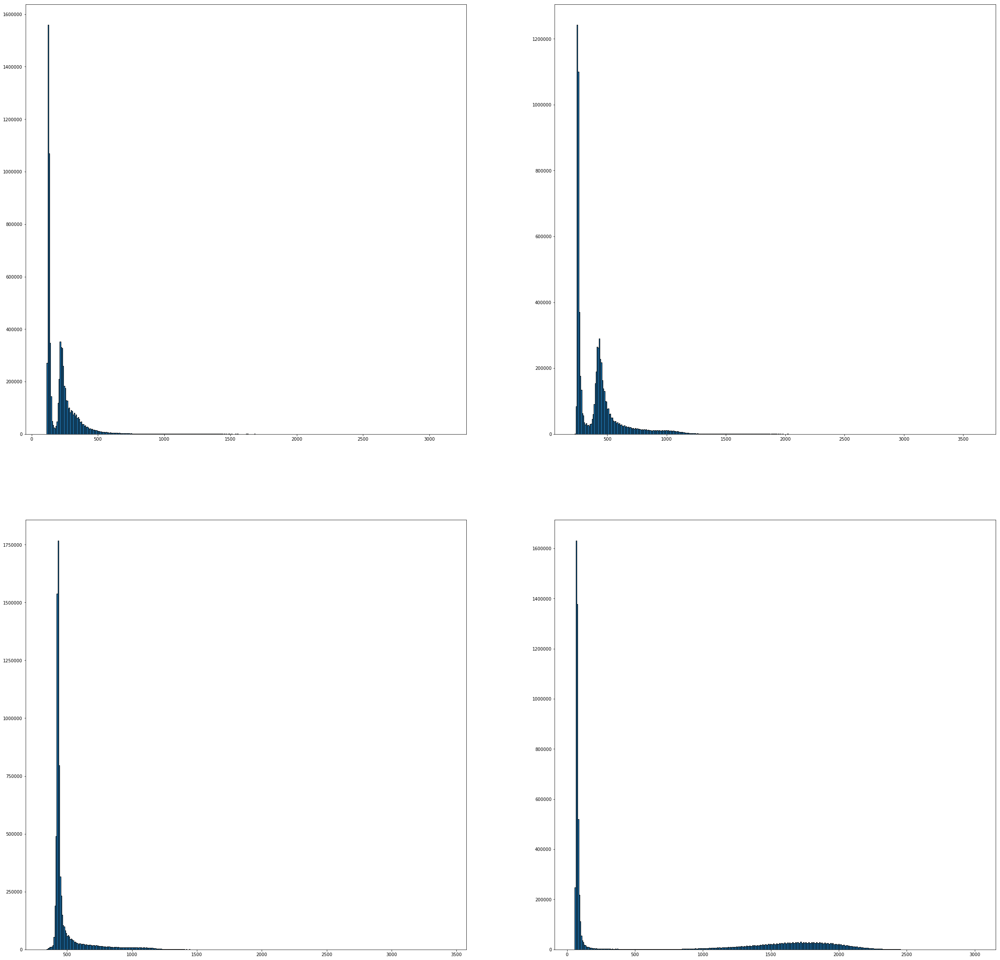

In [5]:
# Display histograms bands
plt.figure(figsize=(40, 40))
for i in range(1,4):
    plt.subplot(2, 2, i)
    plt.hist(RGB_img[:,:,i-1].ravel(), bins=400, ec='k')

plt.subplot(2, 2, 4)
plt.hist(NIR[1000:3500,3400:6400].ravel(), bins=400, ec='k')
plt.show

In [6]:
for i in range(RGB_img.shape[2]):
    v_min, v_max = np.percentile(RGB_img[:,:,i], (2, 95))
    print('percentiles 0.02, 0.98 of band ',str(i),': ',str(v_min),', ',str(v_max),'\n')
    better_contrast[:,:,i] = exposure.rescale_intensity(RGB_img[:,:,i], in_range=(v_min, v_max))
    
print(better_contrast)

percentiles 0.02, 0.98 of band  0 :  121.0 ,  458.0 

percentiles 0.02, 0.98 of band  1 :  242.0 ,  912.0 

percentiles 0.02, 0.98 of band  2 :  406.0 ,  927.0 

[[[   0   97 3270]
  [   0   97 3018]
  [   0    0 2641]
  ..., 
  [4667 2836 5786]
  [2139  684 2767]
  [ 583    0 2012]]

 [[ 583  293 3144]
  [ 583  489 2641]
  [   0  195 2641]
  ..., 
  [6028 3423 5786]
  [2528  782 2138]
  [ 388    0 1761]]

 [[ 583  391 3018]
  [1166  880 3018]
  [ 583  586 3018]
  ..., 
  [7778 4010 6163]
  [3305 1173 2767]
  [ 388   97 2012]]

 ..., 
 [[2528 1075 3522]
  [3305 1075 3773]
  [3500 1662 4528]
  ..., 
  [   0    0 1006]
  [   0    0 1509]
  [   0    0 1383]]

 [[2916 1467 3773]
  [4278 1760 3899]
  [4083 1858 4528]
  ..., 
  [   0    0 1383]
  [   0    0 1635]
  [   0    0 1257]]

 [[3500 2249 4779]
  [4472 2640 4654]
  [4472 2151 4779]
  ..., 
  [   0    0 2264]
  [   0    0 2138]
  [   0    0 1509]]]


<function matplotlib.pyplot.show>

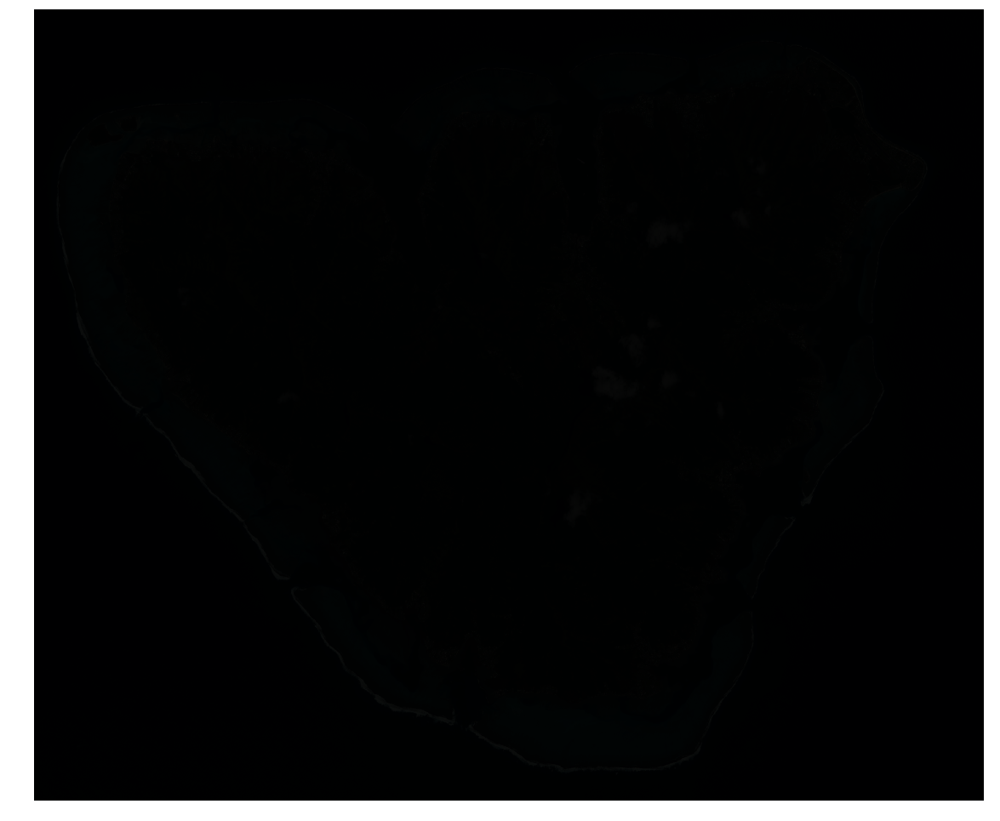

In [58]:
   
plt.figure(figsize=(20, 20))
#plt.subplot(1, 2, 1)
plt.imshow(img_as_float(RGB_img))
#plt.subplot(1, 2, 2)
#plt.imshow(Random)
plt.axis('off')
plt.show

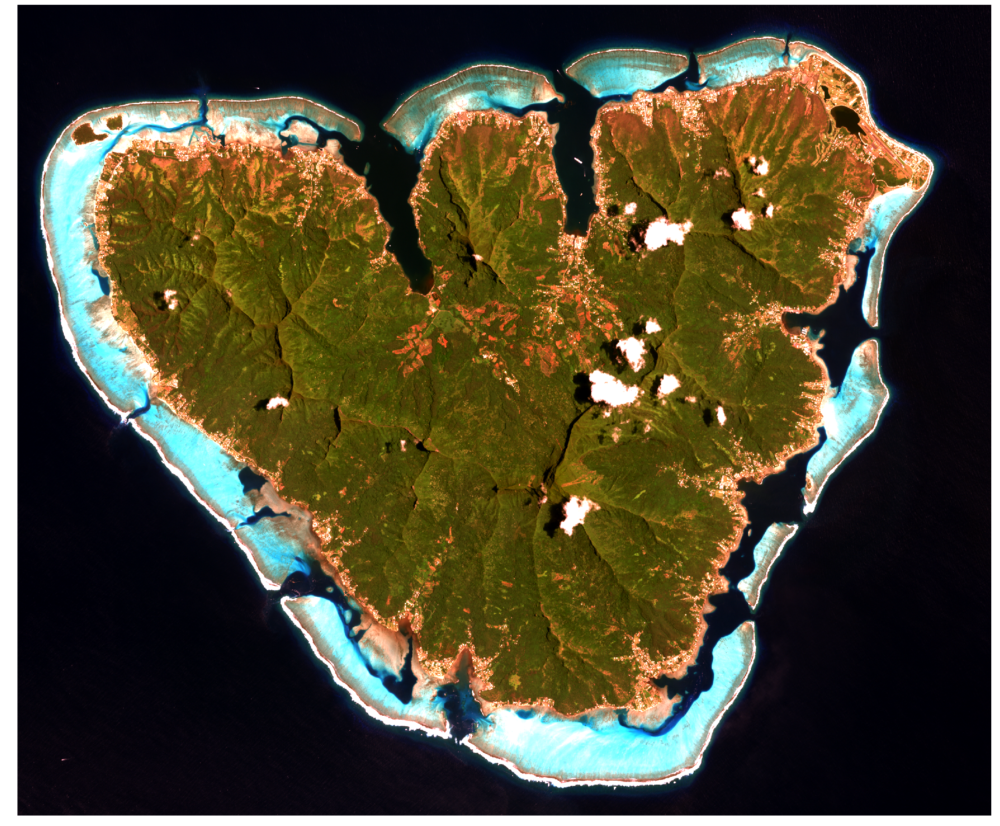

In [7]:
plt.figure(figsize=(40, 40))
#plt.subplot(1, 2, 1)
plt.imshow(img_as_float(better_contrast))
#plt.subplot(1, 2, 2)
#plt.imshow(Random)
plt.axis('off')
plt.show
plt.savefig("figures/IllustrationCont.png", dpi='figure')

<function matplotlib.pyplot.show>

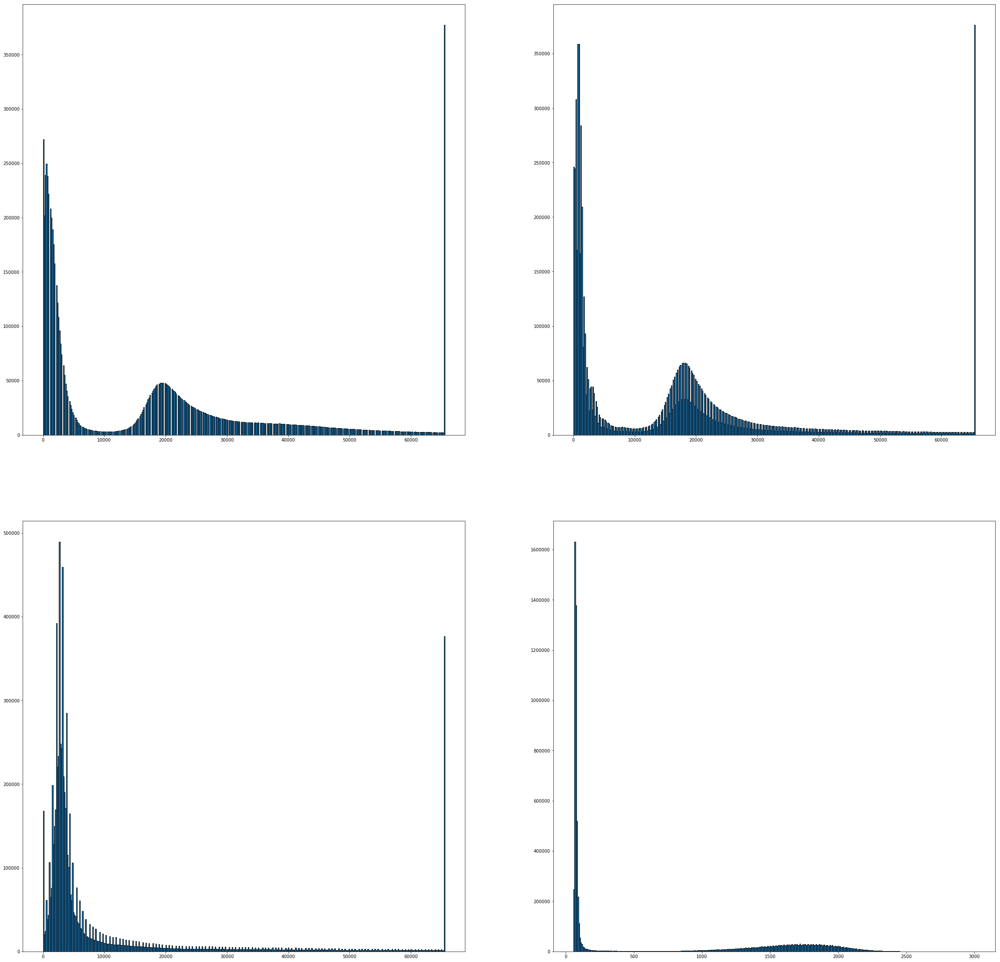

In [8]:
# Display histograms bands
plt.figure(figsize=(40, 40))
for i in range(1,4):
    plt.subplot(2, 2, i)
    plt.hist(better_contrast[:,:,i-1].ravel(), bins=400, ec='k')

plt.subplot(2, 2, 4)
plt.hist(NIR[1000:3500,3400:6400].ravel(), bins=400, ec='k')
plt.show

<function matplotlib.pyplot.show>

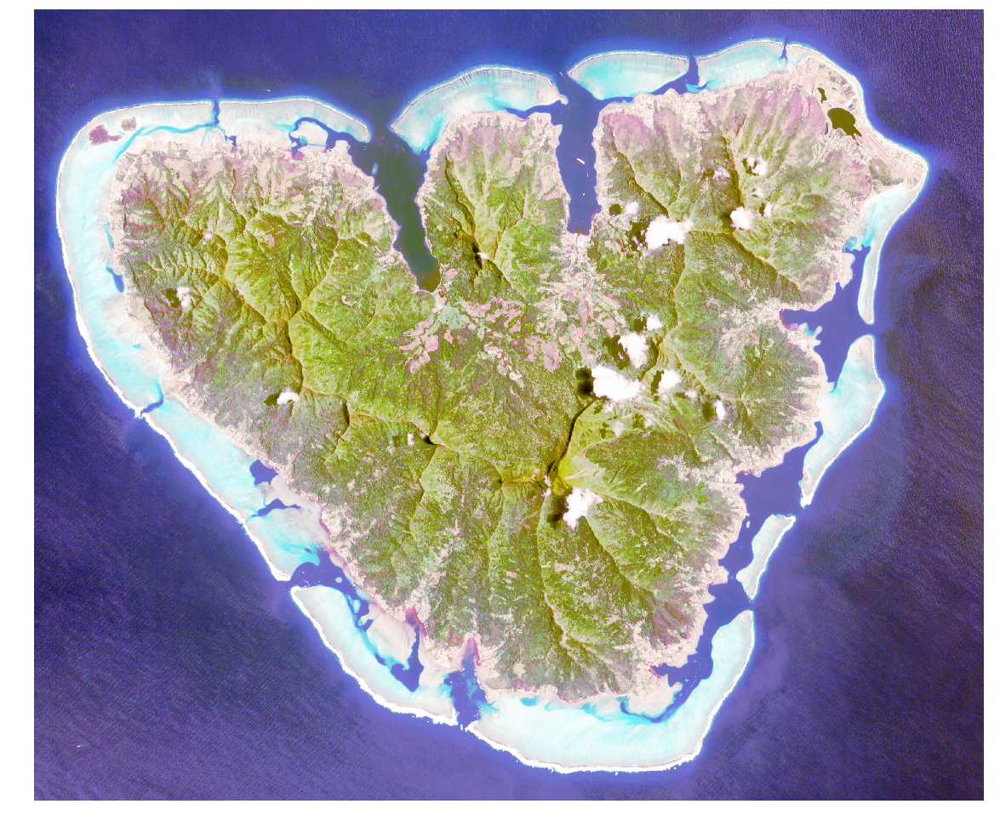

In [60]:
plot_img = np.empty(RGB_img.shape, dtype=float)
for i in range(plot_img.shape[2]):
    plot_img[:,:,i] = exposure.equalize_hist(img_as_float(RGB_img[:,:,i]))
    
plt.figure(figsize=(20, 20))
#plt.subplot(1, 2, 1)
plt.imshow(plot_img)
#plt.subplot(1, 2, 2)
#plt.imshow(Random)
plt.axis('off')
plt.show


<function matplotlib.pyplot.show>

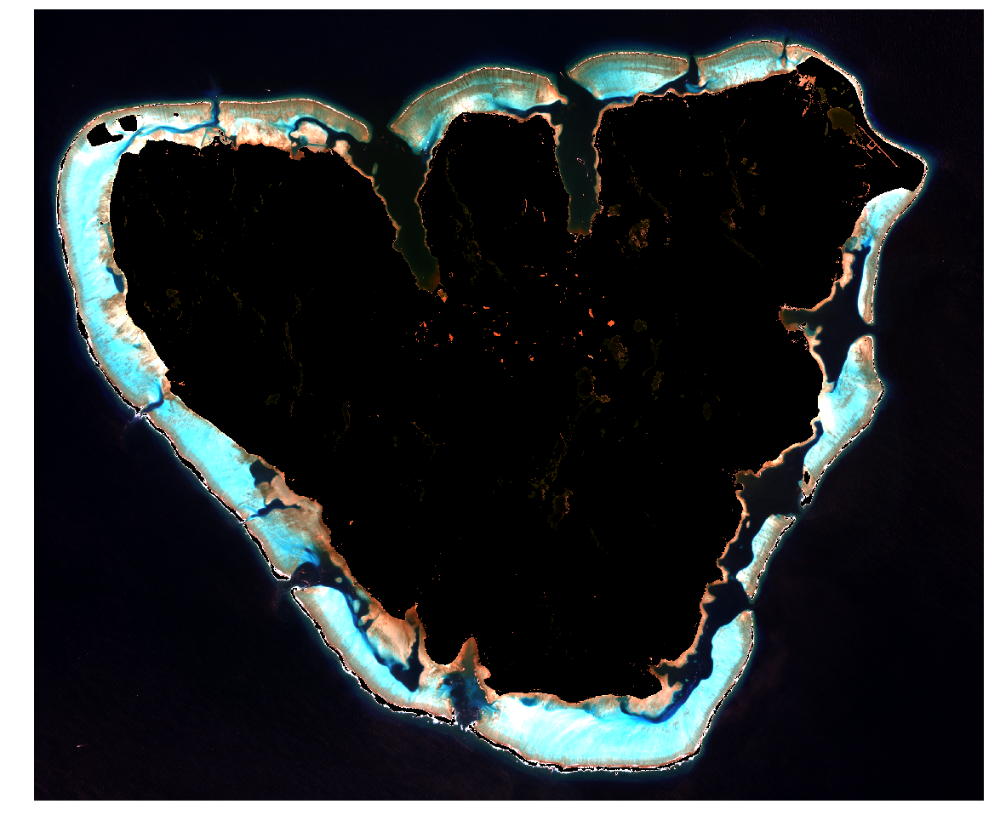

In [39]:
plot_img = img_as_float(better_contrast)
plot_img[NIR[1000:3500,3400:6400]>800] = 0 
plt.figure(figsize=(20, 20))
#plt.subplot(1, 2, 1)
plt.imshow(plot_img)
#plt.subplot(1, 2, 2)
#plt.imshow(Random)
plt.axis('off')
plt.show

<function matplotlib.pyplot.show>

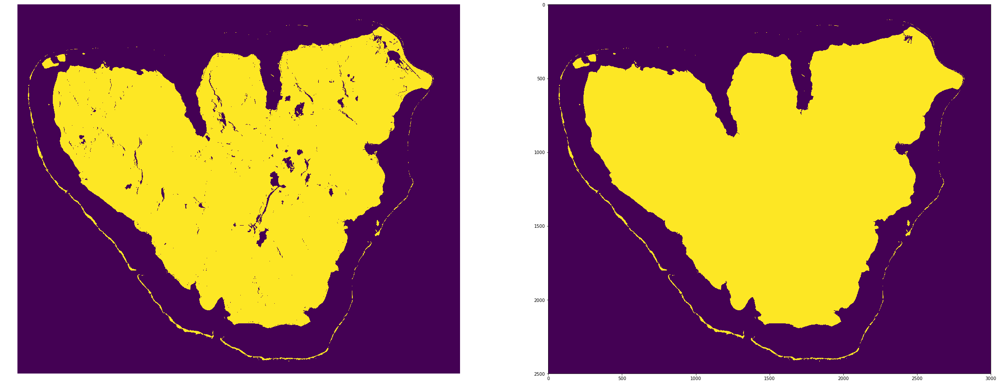

In [131]:
NIR_thres = 800
plt.figure(figsize=(40, 40))
plt.subplot(1, 2, 1)
plt.imshow((NIR[1000:3500,3400:6400]>NIR_thres))
plt.axis('off')

soilFilled_mask = morphology.remove_small_holes(NIR[1000:3500,3400:6400]>NIR_thres,10000)
plt.subplot(1, 2, 2)
plt.imshow(soilFilled_mask)
plt.show

<function matplotlib.pyplot.show>

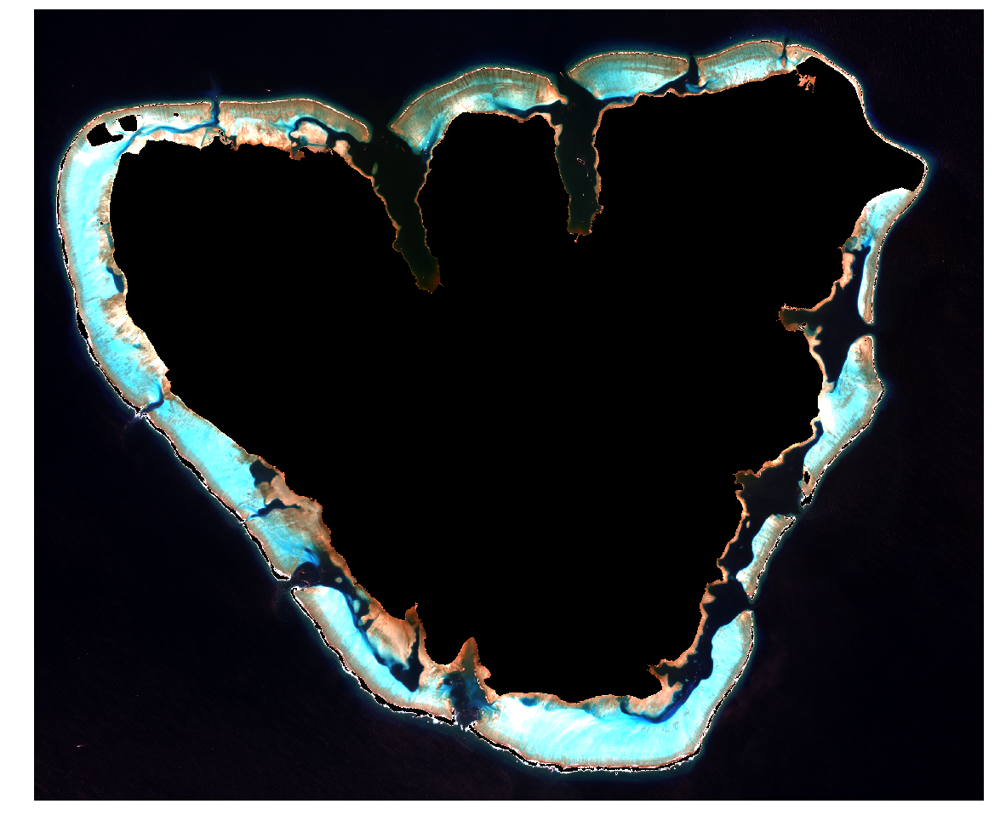

In [128]:
plot_img = img_as_float(better_contrast)
plot_img[soilFilled_mask] = np.NaN
plt.figure(figsize=(20, 20))
#plt.subplot(1, 2, 1)
plt.imshow(plot_img)
#plt.subplot(1, 2, 2)
#plt.imshow(Random)
plt.axis('off')
plt.show

<function matplotlib.pyplot.show>

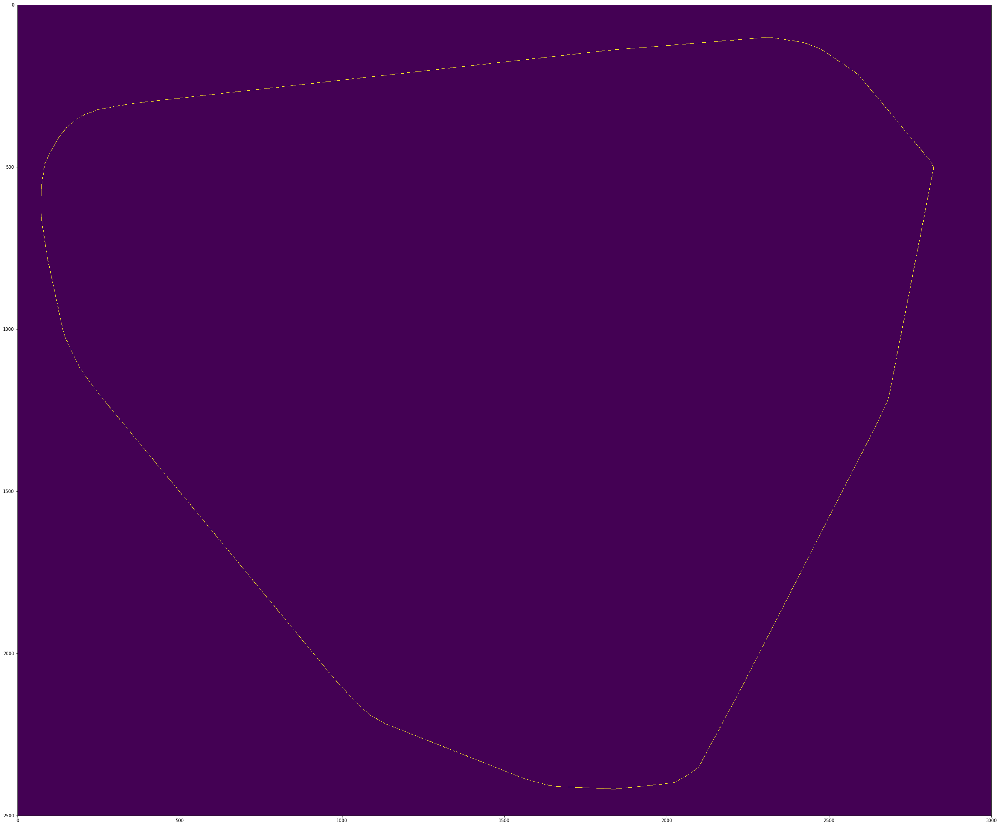

In [111]:
from scipy.spatial import ConvexHull
from PIL import Image, ImageDraw

def convex_hull_image(data):
    region = np.argwhere(data)
    hull = ConvexHull(region,incremental=True)
    verts = [(region[v,0], region[v,1]) for v in hull.vertices]
    img = Image.new('L', data.shape, 0)
    ImageDraw.Draw(img).polygon(verts, outline=1, fill=1)
    mask = np.array(img)

    return mask.T

# Display histograms bands
plt.figure(figsize=(40, 40))
plt.imshow(convex_hull_image(NIR[1000:3500,3400:6400]>800))
plt.show

In [43]:
print((convex_hull_image(NIR[1000:3500,3400:6400]>500)).astype(np.bool))

[[False False False ..., False False False]
 [False False False ..., False False False]
 [False False False ..., False False False]
 ..., 
 [False False False ..., False False False]
 [False False False ..., False False False]
 [False False False ..., False False False]]


In [112]:
closed_image = morphology.binary_closing(NIR[1000:3500,3400:6400]>800, morphology.diamond(1)).astype(np.bool)


for i in range(10):
    closed_image = morphology.binary_closing(closed_image, morphology.cross(1).astype(np.bool))

    
print(itercount)
plt.figure(figsize=(40, 40))
plt.subplot(1, 2, 1)
plt.imshow(NIR[1000:3500,3400:6400]>800)
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(closed_image)
plt.show

AttributeError: module 'skimage.morphology' has no attribute 'cross'

1


TypeError: Image data can not convert to float

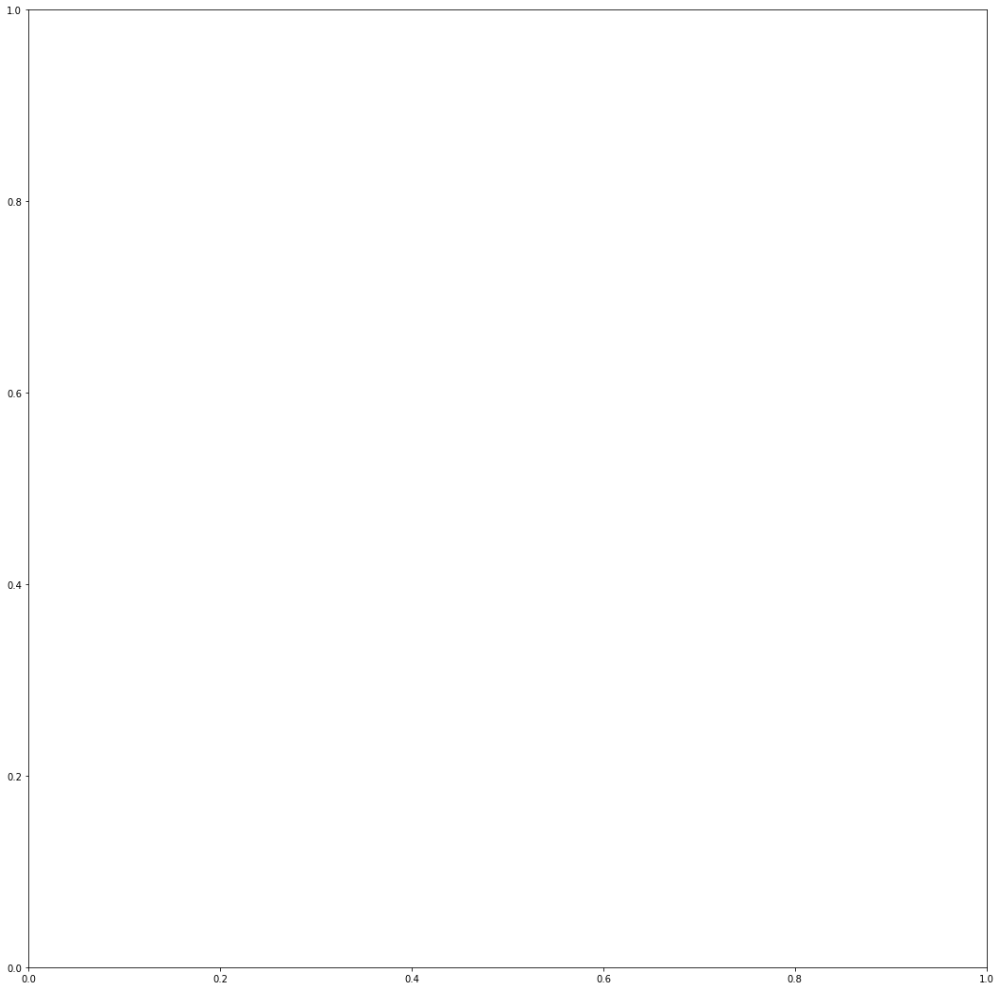

In [109]:
closed_image_next = morphology.binary_closing(NIR[1000:3500,3400:6400]>800, morphology.diamond(1)).astype(np.bool)
closed_image_previous = np.zeros(closed_image_next.shape).astype(np.bool)
itercount = 0

while not np.array_equal(closed_image_previous , closed_image_next):
    itercount = itercount + 1
    closed_image_previous = np.copy(closed_image_next)
    closed_image_next = morphology.binary_closing(closed_image_next, morphology.diamond(1).astype(np.bool))
    if itercount > 1000:
        print('breking')
        break
    
print(itercount)
plt.figure(figsize=(40, 40))
plt.subplot(1, 2, 1)
plt.imshow((NIR[1000:3500,3400:6400]>800).fill(0))
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(closed_image_next)
plt.show

In [97]:
closed_image_next = morphology.binary_closing(NIR[1000:3500,3400:6400]>800, morphology.diamond(10)).astype(np.bool)
closed_image_previous = np.zeros(closed_image_next.shape).astype(np.bool)
itercount = 0

In [100]:
closed_image_previous = np.copy(closed_image_next)

In [102]:
closed_image_next = morphology.binary_closing(closed_image_next, morphology.diamond(10).astype(np.bool))

In [103]:
 np.array_equal(closed_image_previous , closed_image_next)

True

In [ ]:
closed_image = morphology.binary_closing(NIR[1000:3500,3400:6400]>800, morphology.diamond(1)).astype(np.bool)
itercount = 0

itercount = itercount + 1
closed_image_previous = np.copy(closed_image_next)
closed_image = morphology.binary_closing(closed_image, morphology.diamond(1).astype(np.bool))

print(itercount)
plt.figure(figsize=(40, 40))
plt.subplot(1, 2, 1)
plt.imshow(NIR[1000:3500,3400:6400]>800)
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(closed_image_next)
plt.show